# Procesamiento Adaptativo de Señales Aleatorias
# Trabajo Práctico N°2 - Filtro óptimo

## Grupo 3
* Santiago Arribere
* Matías Francois
* Joaquín Gaytan
* Pablo Scheinfeld

## Notebook #1 - Análisis de señales
En la siguiente notebook se generan y analizan las señales de excitación empleadas para realizar la estimación de la respuesta impulsiva de una habitación, mediante el uso de filtrado óptimo.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal as sps
from IPython.display import Audio
from scipy.io import wavfile
from scipy import linalg, hamming
from scipy.fft import fft, fftfreq

In [2]:
from helper import *

Las señales de excitación se caracterizan por tener una duración fija de diez segundos, grabando luego una respuesta cuyo largo deberá exceder al de estas. Por otro lado, se eligió una frecuencia de muestreo de 44100 Hz (en lugar de los 48000 Hz sugeridos) dado que en este caso se emplearon dispositivos de reproducción y grabación con este valor de frecuencia de muestreo como estándar.

In [3]:
# Define samplerate for input signals
samplerate = 44100 # Hz

# Define track length
tracklen = 10 # sec

# 1. Señales de excitación
A continuación, se enumeran las señales propuestas como entrada del sistema físico a modelar, mostrando su espectrograma para poder apreciar su contenido espectral a lo largo del tiempo. También se grafican los espectrogramas de las correspondientes grabaciones de a respuesta del sistema ante cada señal estímulo. Al momento de elegir estas señales, se busca que su espectro sea lo suficientemente amplio y uniforme de forma tal de excitar la mayor cantidad posible de modos.

In [4]:
# Define paths for each signal file
base = '..'
record_base = base + '/assets/recorded_sounds/wavs/'
original_base = base + '/assets/test_signals/'
audios_dict = {
    # AudioType: (recorded, original)
    'song': 'darkside.wav',
    'voice': 'whereiam.wav',
    'linear sweep': 'linear.wav',
    'periodic linear sweep': 'multiple_lin.wav',
    'exp sweep': 'exponential.wav',
    'periodic exp sweep': 'multiple_exp.wav',
    'square': 'rectangular.wav',
    'wgn': 'white-noise.wav'
}

## 1.1 Señal de voz
El contenido espectral de una señal de voz se encuentra típicamente en el rango comprendido entre 300 Hz y 3000 Hz, siendo esta banda una pequeña porción del espectro audible (de hecho, las señales de voz suelen muestrearse a una frecuencia inferior). Por lo tanto, se eligió un fragmento de audio que cubra ampliamente este rango, sabiendo que al dejar una gran extensión del espectro audible sin excitar la estimación generada con esta señal no será lo suficientemente representativa.

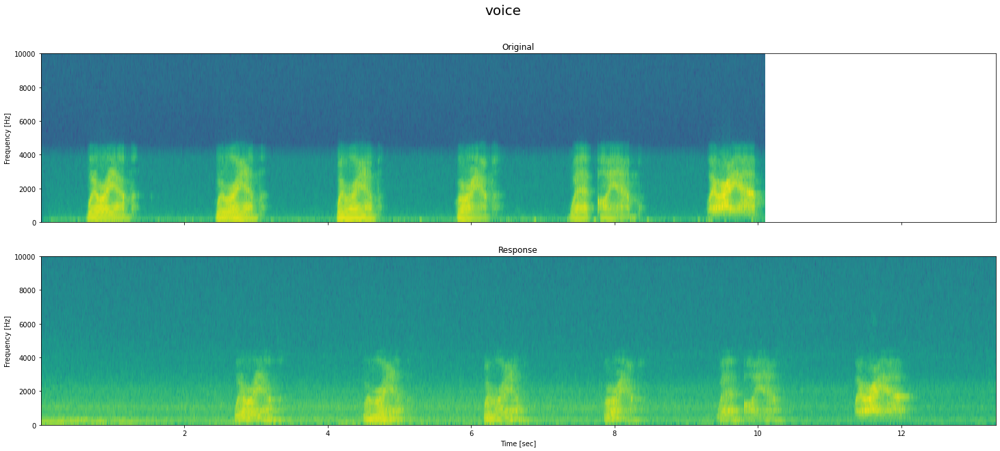

In [5]:
tag = 'voice'

# Plot spectrograms
plot_spectrograms(original_base + audios_dict[tag], record_base + audios_dict[tag], tag, ylim=(0,10000))

In [6]:
print(f'Original signal [{tag}]')
Audio(original_base + audios_dict[tag])

Original signal [voice]


In [7]:
print(f'Response [{tag}]')
Audio(record_base + audios_dict[tag])

Response [voice]


## 1.2 Fragmento de canción
A diferencia de una señal de voz, las señales de música presentan sonidos instrumentales, cuyos contenidos armónicos se extienden hasta la banda de los 15 KHz (dependiendo del tipo de instrumento). Por lo tanto, se buscó una canción que contenga tanto bajos como altos, configurando un espectro poblado. Luego, esta señal parece más apropiada para lograr una estimación correcta de la respuesta impulsiva del sistema físico. 

D:\Users\Joaco\Desktop\repos\PASA\pasa-tp2\src\helper.py:13: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs_o, y_o = wavfile.read(original)


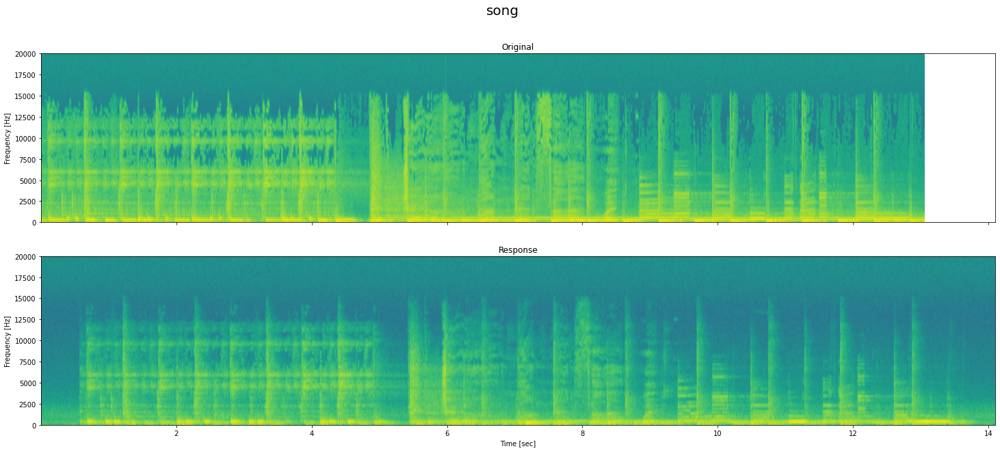

In [8]:
tag = 'song'

# Plot spectrograms
plot_spectrograms(original_base + audios_dict[tag], record_base + audios_dict[tag], tag, ylim=(0,20000))

In [9]:
print(f'Original signal [{tag}]')
Audio(original_base + audios_dict[tag])

Original signal [song]


In [10]:
print(f'Response [{tag}]')
Audio(record_base + audios_dict[tag])

Response [song]


## 1.3 Señal rectangular
La señal rectangular ideal presenta un espectro de frecuencias de largo infinito, pero sólo en la frecuencia central (en este caso, 100 Hz) y sus armónicas. Por ende, suponemos que los resultado obtenidos con esta señal no serán los más representativos.

c:\users\joaco\appdata\local\programs\python\python39\lib\site-packages\matplotlib\axes\_axes.py:7553: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


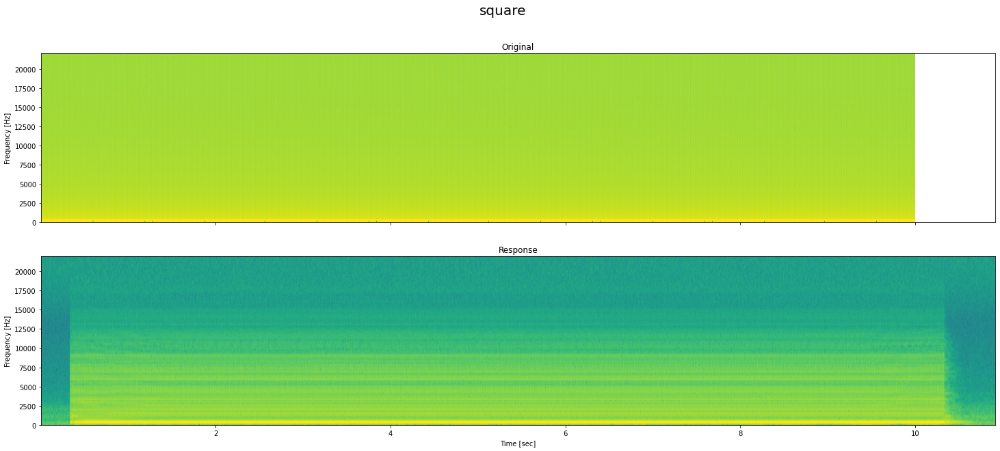

In [11]:
tag = 'square'

# Signal parameters
rec_freq = 100 # Hz

# Generate square signal
rec_t = np.arange(0, tracklen, 1/samplerate)
rec = sps.square(rec_t*2*np.pi*rec_freq) 

# Generate WAV file
rec_scaled = to_wav(rec, samplerate, original_base + audios_dict[tag][1], scale=0.9)

# Plot spectrograms
plot_spectrograms(original_base + audios_dict[tag], record_base + audios_dict[tag], tag, ylim=(0,22000))

In [12]:
print(f'Original signal [{tag}]')
Audio(original_base + audios_dict[tag])

Original signal [square]


In [13]:
print(f'Response [{tag}]')
Audio(record_base + audios_dict[tag])

Response [square]


## 1.4 Barrido lineal en frecuencia
La siguiente señal corresponde a un barrido (o *chirp*) lineal en frecuencia. El mismo abarca un rango que va desde 20 Hz hasta 20 kHz, comprendiendo todo el espectro audible. Consecuentemente, este presenta una densidad de potencia uniforme en todo el rango espectral, excitando todos los modos de la habitación de igual manera. Esto posibilita lograr una mejor estimación de la respuesta impulsiva de la habitación.

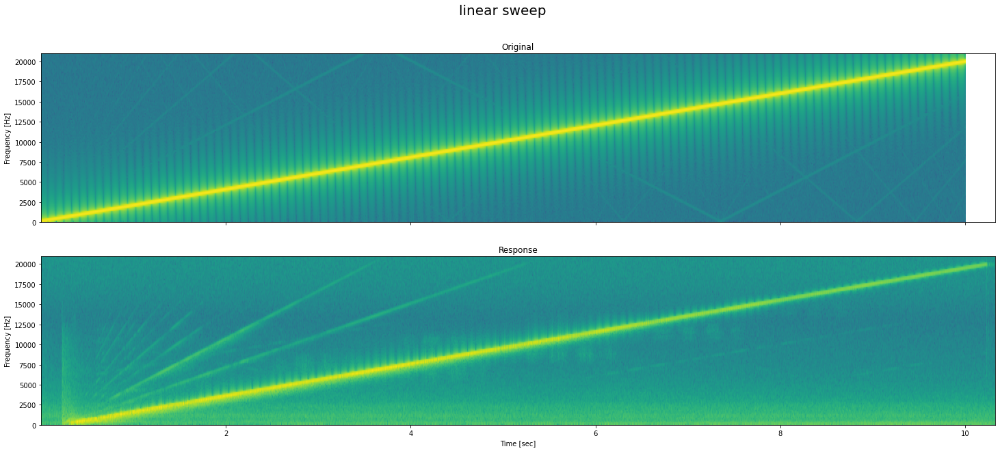

In [14]:
tag = 'linear sweep'

ls_f0 = 20 # Hz
ls_f1 = 20000 # Hz

ls_t = np.arange(0, tracklen, 1/samplerate)

# Generate frequency sweep
linear_sweep = sps.chirp(ls_t, ls_f0, ls_t[-1], ls_f1, method='linear')

# Generate WAV file
linear_sweep_scaled = to_wav(linear_sweep, samplerate, original_base + audios_dict[tag][1], scale=0.9)

# Plot spectrograms
plot_spectrograms(original_base + audios_dict[tag], record_base + audios_dict[tag], tag, ylim=(0,21000))

In [15]:
print(f'Original signal [{tag}]')
Audio(original_base + audios_dict[tag])

Original signal [linear sweep]


In [16]:
print(f'Response [{tag}]')
Audio(record_base + audios_dict[tag])

Response [linear sweep]


## 1.5 Barrido lineal en frecuencia (periódico)

A modo de prueba, se decidión implementar un tren de barridos lineales en frecuencia de un segundo de duración, como se aprecia en la figura siguiente. Consideramos que diez repeticiones de este barrido eran suficientes.

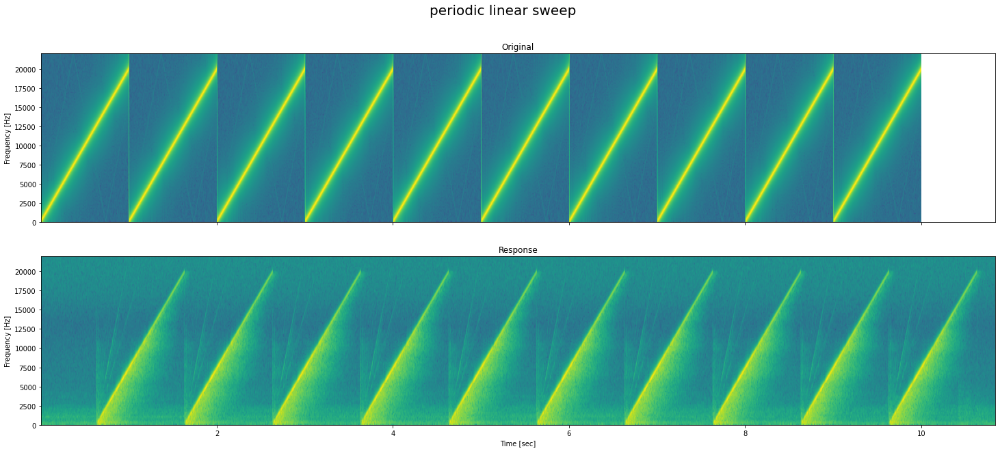

In [17]:
tag = 'periodic linear sweep'

lsp_f0 = 20 # Hz
lsp_f1 = 20000 # Hz

lsp_t = np.arange(0, 1, 1.0/samplerate)

it = 10 # sec

lsp_t_total = np.arange(0, it, 1.0/samplerate)

linear_sweep_periodic = np.array([])

for i in range(it):
    # Generate frequency sweep
    lsp_period = sps.chirp(lsp_t, lsp_f0, lsp_t[-1], lsp_f1, method='linear')
    linear_sweep_periodic = np.concatenate((linear_sweep_periodic, lsp_period), axis=None)
    
# Generate WAV file
linear_sweep_scaled = to_wav(linear_sweep_periodic, samplerate,original_base + audios_dict[tag][1], scale=0.9)

# Plot spectrograms
plot_spectrograms(original_base + audios_dict[tag], record_base + audios_dict[tag], tag, ylim=(0,22000))

In [18]:
print(f'Original signal [{tag}]')
Audio(original_base + audios_dict[tag])

Original signal [periodic linear sweep]


In [19]:
print(f'Response [{tag}]')
Audio(record_base + audios_dict[tag])

Response [periodic linear sweep]


## 1.6 Barrido exponencial en frecuencia
El barrido exponencial en frecuencia comparte su origen que el barrido, ya que ambos excitan a todos los modos del sistema físico. A diferencia del anterior, este barrido tiene mayor resolución en la zona baja del espectro, derivando en diferentes relaciones señal a ruido en los distintos rangos de frecuencia.

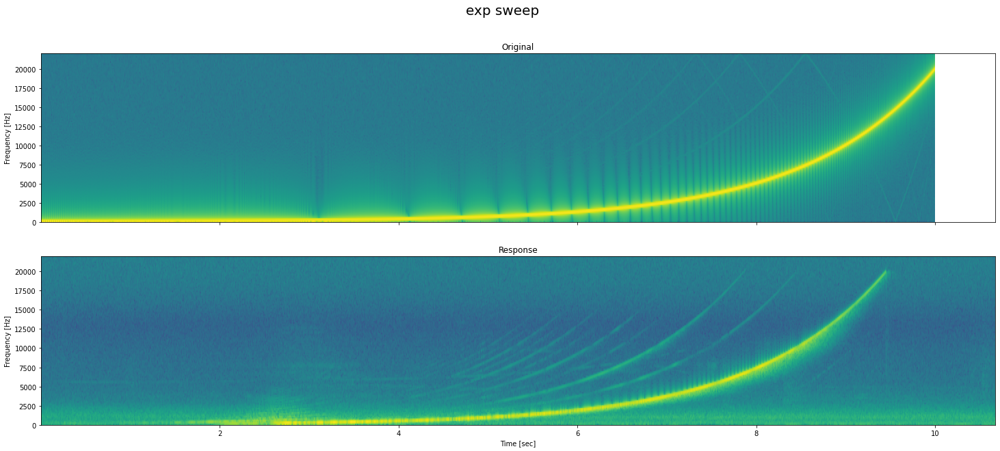

In [20]:
tag = 'exp sweep'

# First declare the variables
es_f0 = 20
es_f1 = 20e3
es_T = 10

es_N = es_T*samplerate

# create the array with times
es_time = np.linspace(0, es_N/samplerate, es_N)
es_k = (es_f1/es_f0)**(1/es_T)

# array with variable k^t
es_k_t = np.array([es_k**i for i in es_time])

# array with output signal
es = np.sin(2*np.pi*es_f0*(es_k_t - 1)/np.log(es_k))

# Generate WAV file
es_scaled = to_wav(es, samplerate,original_base + audios_dict[tag][1], scale=0.9)

# Plot spectrograms
plot_spectrograms(original_base + audios_dict[tag], record_base + audios_dict[tag], tag, ylim=(0,22000))

In [21]:
print(f'Original signal [{tag}]')
Audio(original_base + audios_dict[tag])

Original signal [exp sweep]


In [22]:
print(f'Response [{tag}]')
Audio(record_base + audios_dict[tag])

Response [exp sweep]


## 1.7 Barrido exponencial en frecuencia (periódico)
Se realiza la extensión periódica del barrido anterior, en iguales condiciones respecto del barrido lineal periódico.

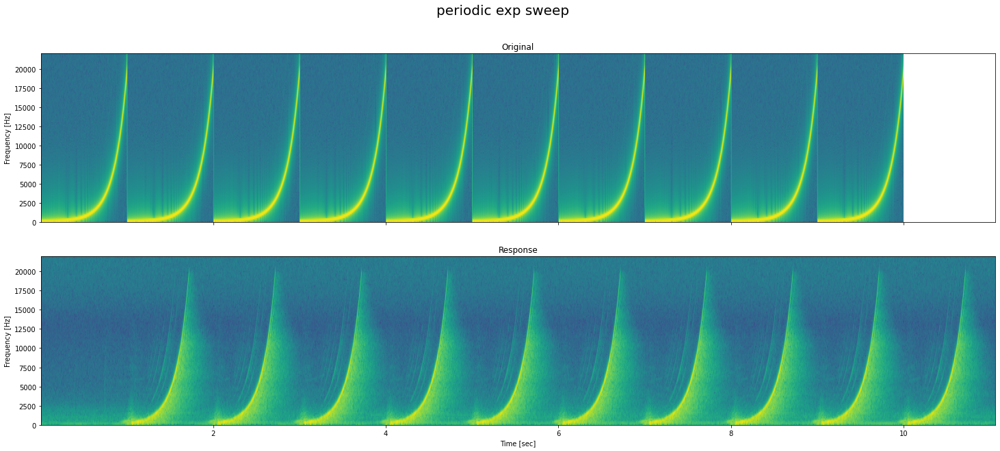

In [23]:
tag = 'periodic exp sweep'

esp_f0 = 20 # Hz
esp_f1 = 20000 # Hz

esp_T = 1
esp_t = np.arange(0, esp_T, 1.0/samplerate)

it = 10 # sec

esp_t_total = np.arange(0, it, 1.0/samplerate)


total_exp_sweep = np.array([])


for i in range(it):
    esp_N = esp_T*samplerate
    # create the array with times
    esp_time = np.linspace(0, esp_N/samplerate, esp_N)
    esp_k = (esp_f1/esp_f0)**(1/esp_T)

    # array with variable k^t
    esp_k_t = np.array([esp_k**i for i in esp_time])

    # array with output signal
    exp_sweep = np.sin(2*np.pi*esp_f0*(esp_k_t - 1)/np.log(esp_k))
    
    total_exp_sweep = np.concatenate((total_exp_sweep, exp_sweep), axis=None)

# Generate WAV file
total_exp_sweep_scaled = to_wav(total_exp_sweep, samplerate,original_base + audios_dict[tag][1], scale=0.9)

# Plot spectrograms
plot_spectrograms(original_base + audios_dict[tag], record_base + audios_dict[tag], tag, ylim=(0,22000))

In [24]:
print(f'Original signal [{tag}]')
Audio(original_base + audios_dict[tag])

Original signal [periodic exp sweep]


In [25]:
print(f'Response [{tag}]')
Audio(record_base + audios_dict[tag])

Response [periodic exp sweep]


## 1.8 Ruido blanco gaussiano
Por último, se genera una señal de ruido blanco gausiano incorrelacionado, de media nula y varianza unitaria. Dada su incorrelación, suponemos que estimar la respuesta impulsiva de la habitación con esta señal derivará en una estimación con un alto grado de componentes estocásticas, resultando en un error elevado.

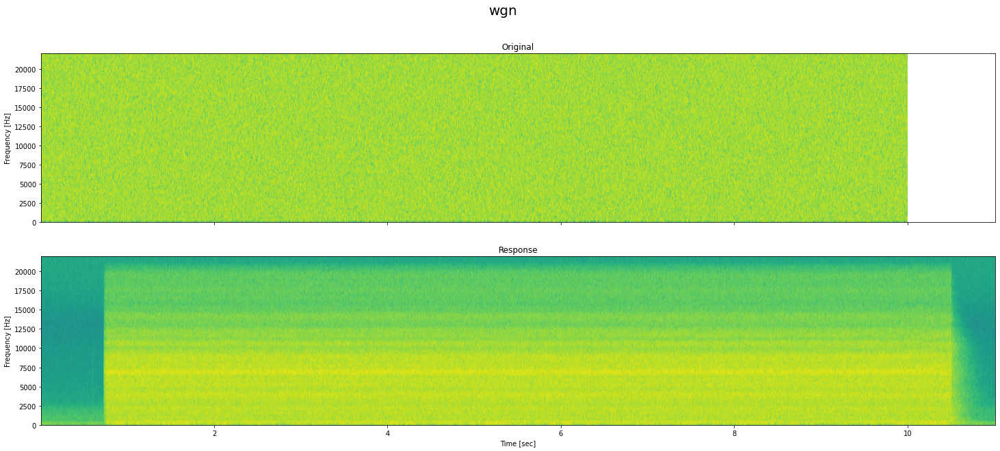

In [26]:
tag = 'wgn'

wgn_sigma = 1

wgn_t = np.arange(0, tracklen, 1/samplerate)

# Generate white gaussian noise signal
wgn = np.random.normal(0, wgn_sigma, wgn_t.shape[0]) # Media 0, varianza 1. Ruido Gaussiano.

# Generate WAV file
wgn_scaled = to_wav(wgn, samplerate,original_base + audios_dict[tag][1], scale=0.9)

# Plot spectrograms
plot_spectrograms(original_base + audios_dict[tag], record_base + audios_dict[tag], tag, ylim=(0,22000))

In [27]:
print(f'Original signal [{tag}]')
Audio(original_base + audios_dict[tag])

Original signal [wgn]


In [28]:
print(f'Response [{tag}]')
Audio(record_base + audios_dict[tag])

Response [wgn]
